# **Isolamento strumentale**

## di Edoardo Oldani S4675431
## collaboratore: Gabriele Lanteri S4638890

## Questo notebook è stato realizzato con l'idea di analizzare una canzone e riuscire a scomporla in più parti. La scomposizione eseguita divide la traccia iniziale in parte armonica e percussiva. Dopodiché isoleremo la parte strumentale rimuovendo la parte vocale e riapplicheremo lo stesso procedimento per avere come risultato solo parte musicale divisa in parte armonica e percussiva. 


## **Prima parte**, inizializzazione progetto:
### Il progetto inizia importando librerie e caricando all'interno del notebook la traccia audio.

### Iniziamo importando le librerie standard python e per il progetto utilizzeremo Librosa

In [33]:
import numpy as np
import matplotlib.pyplot as plt
import IPython

import warnings

warnings.filterwarnings("ignore")
%matplotlib inline

import librosa
import librosa.display

### Selezioniamo la canzone ed impostiamo la durata che vogliamo salvare e la carichiamo

In [34]:
#Choose the song to execute and the duration (in sec)
song = 'smellsliketeenspirits.mp3'

Il metodo load carica un file audio come una serie temporale a floating point 
(y) che verrà ricampionato automaticamente alla frequenza indicata (sr, 
default=22050)

In [35]:
duration = 60

y, sr = librosa.load(song, duration=duration)

### Riproduco e plotto il grafico

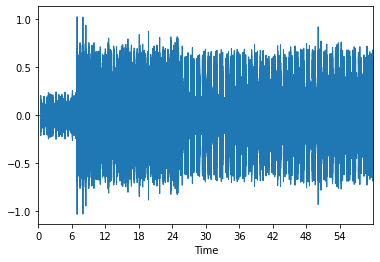

In [36]:
#Plotto la traccia audio e la riproduco
librosa.display.waveplot(y)

IPython.display.Audio(data=y, rate=sr)

### Ne eseguo la trasformata di Fourier discreta e dopodiché convertiamo lo spettrogramma in uno deciBell-scaled e lo mostriamo
 La "stft" è la short time Fourier transform: consiste nella trasformata di Fourier ma divide un segnale a lunga durata e lo divide in segmenti della stessa lunghezza, dopodiché ne esegue per ognuno la trasformata di Fourier.

In [37]:
y_ft = librosa.stft(y)

###Plotto lo spettrogramma
Siccome il range di pressione sonora percepibile è molto più ampio rispetto alla percezione umana approssimiamo la scala di valori utilizzando "amplitude_to_db" che converte il segnale in una scala logaritmica. Il risultato quindi è un plot in cui riusciamo a vedere corrispondenze con quello che sentiamo.

---


Lo spettrogramma rappresenta un segnale che mostra la relazione tra 3 variabili che caratterizzano qualsiasi suono:

Frequenza (asse verticale);

Tempo (asse orizzontale);

Intensità (scala di colori).

Attraverso l’uso di uno spettrogramma è possibile rendersi conto di come è costituito un suono. 

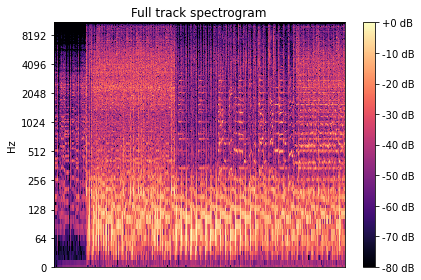

In [38]:
plt.figure()

dbScaled = librosa.amplitude_to_db(np.abs(y_ft), ref=np.max)

librosa.display.specshow(dbScaled, y_axis='log')

plt.colorbar(format= '%+2.0f dB')
plt.title('Full track spectrogram')

plt.tight_layout()

##**Terza** parte, creazione maschere:
###In questa parte andiamo a ricavare la parte armonica e percussiva calcolando delle maschere e applicandole al segnale.

###Ricaviamo le due maschere
Per trovare le due maschere andremo ad utilizzare il metodo che utilizza la funzione chiamata in precedenza per trovare le due parti in modo rapido: librosa.decompose.hpss.
Siccome il metodo in precedenza chiamava in pipeline tre metodi esterni noi andremo a passare alla decompose il risultato della stft.
Il parametro "margin" permette di isolare al meglio le singole parti, se il valore è una tupla allora andiamo ad esaltare con valori diversi le due parti (harm,perc)

In [39]:
mask_harm, mask_perc = librosa.decompose.hpss(y_ft, mask=True, margin=(5.0, 3.0))

###Mostriamo le due maschere

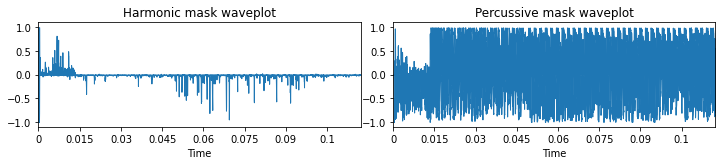

In [40]:
plt.figure(figsize=(10,4))

plt.subplot(2, 2, 1)
librosa.display.waveplot(mask_harm)
plt.title('Harmonic mask waveplot')

plt.subplot(2, 2, 2)

librosa.display.waveplot(mask_perc)
plt.title('Percussive mask waveplot')

plt.tight_layout()

###Stabiliamo i giusti valori per isolare meglio le componenti
Rendiamo positivi tutti i valori del segnale dopo la trasformata di Fourier e troviamo la potenza giusta, che quindi isoli bene le due parti limitando il più possibili errori o "buchi", ricavando il segnale intero. 

Infine calcoliamo la fase che non è una proprietà di un solo segnale ma implica invece la relazione tra due o più segnali che condividono la stessa frequenza. Se i picchi di due segnali con la stessa frequenza sono esattamente allineati allo stesso tempo si dice che sono in fase.

In [41]:
power=1.5
S_full = np.abs(y_ft)
S_full **= power
phase = np.exp(1.0j * np.angle(y_ft))

###Calcoliamo la parte armonica e percussiva
Adesso andiamo ad applicare la maschera al segnale iniziale e moltiplichiamo anche per la phase. Dopo questi calcoli ci basta effettuare la trasformata di Fourier inversa per ottenere i due segnali divisi.

In [42]:
harm_masked = mask_harm * S_full * phase
perc_masked = mask_perc * S_full * phase

y_harmonic = librosa.istft(harm_masked)
y_percussive = librosa.istft(perc_masked)

###Mostriamo il segnale e ascoltiamo le tracce

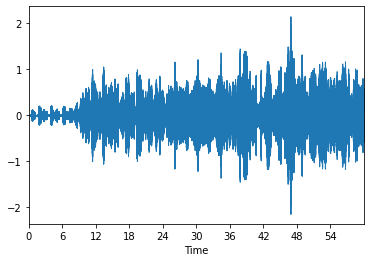

In [43]:
librosa.display.waveplot(y_harmonic)
IPython.display.Audio(data=y_harmonic, rate=sr)

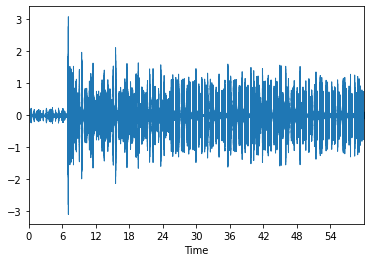

In [44]:
librosa.display.waveplot(y_percussive)
IPython.display.Audio(data=y_percussive, rate=sr)

## **Quarta** parte, spettrogrammi a confronto:
### In questa parte andremo a mostrare ed analizzare gli spettrogrammi della traccia e delle parti trovate in precedenza. 

### Decompongo lo spettrogramma
Questa volta non andiamo a creare delle maschere da applicare poi al segnale ma andremo a ritornare gli spettrogrammi relativi a parte armonica e percussiva.
Assegnando al "margin" un valore maggiore di 1.0 andremo anche a ricavare il residuo, quindi i valori che non appartengono a nessuna delle due parti, utilizziamo il valore impostato al momento della creazione delle maschere. 

In [45]:
Harm, Perc= librosa.decompose.hpss(y_ft, margin=(5.0, 3.0))

Res = y_ft - (Harm + Perc)

### Visualizzazione degli spettrogrammi
Il primo plot è lo spettrogramma relativo alla canzone iniziale senza modifiche, gli altri due sono gli spettrogrammi della canzone filtrata (senza rumore) con la maschera relativa applicata

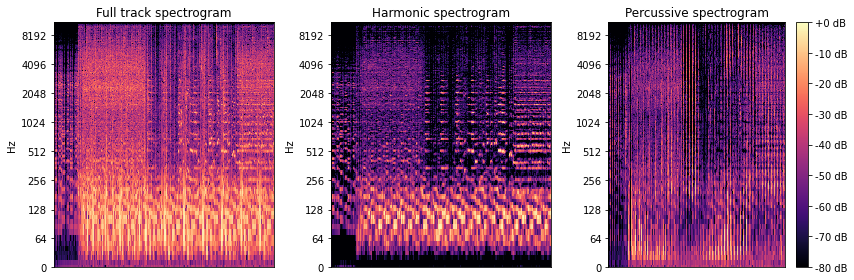

In [46]:
plt.figure(figsize=(12,4))
plt.subplot(1, 3, 1)
librosa.display.specshow(dbScaled, y_axis='log')
plt.title('Full track spectrogram')

plt.subplot(1, 3, 2)
librosa.display.specshow(librosa.amplitude_to_db(np.abs(Harm),ref=np.max), y_axis='log')
plt.title('Harmonic spectrogram')

plt.subplot(1, 3, 3)
librosa.display.specshow(librosa.amplitude_to_db(np.abs(Perc), ref=np.max), y_axis='log')
plt.title('Percussive spectrogram')

plt.colorbar(format='%+2.0f dB')
plt.tight_layout()

### Spettrogramma del residuo
Come si può notare i valori del residuo sono alti, questo perché essendo una canzone complessa, con molti strumenti, è difficile isolare solo la parte armonica e percussiva

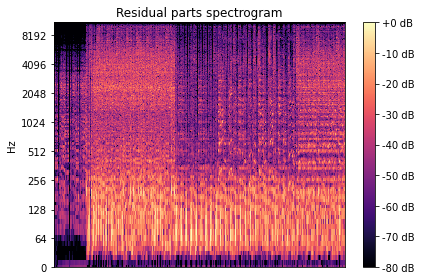

In [47]:
plt.figure()

resSpec = librosa.amplitude_to_db(np.abs(Res), ref=np.max)

librosa.display.specshow(resSpec, y_axis='log')

plt.colorbar(format= '%+2.0f dB')
plt.title('Residual parts spectrogram')

plt.tight_layout()

## **Quinta parte**, separazione della parte strumentale:
### Adesso separiamo la parte strumentale da quella vocale, per farlo andremo prima a rimuovere il rumore e successivamente a creare ed applicare una maschera

###Filtriamo il segnale rimuovendo il rumore
Utilizziamo la nn_filter per pulire il segnale, la metrica è del coseno quindi applichiamo la similarità del coseno e separiamo i frame simili di almeno 2 secondi in modo tale da non essere ingannati dalla continuità locale.

In seguito andiamo a prendere i valori minimi di entrambi i segnali

In [48]:
S_filter = librosa.decompose.nn_filter(S_full,
                                       aggregate=np.median,
                                       metric='cosine',
                                       width=int(librosa.time_to_frames(2, sr=sr)))

S_filter= np.minimum(S_full, S_filter)

### Creiamo la maschera per la parte strumentale
Per creare la maschera questa volta utilizziamo il metodo softmask, utilizzato internamente anche da decompose.hpss. Come parametro per la maschera abbiamo bisogno di una potenza e di un margine, utilizzato per accentuare valori bassi e quindi isolare solo la parte strumentale

In [49]:
margin_i = 2
power = 2

mask_i = librosa.util.softmask(S_filter, margin_i * (S_full - S_filter), power=power)

###Ricaviamo il risultato della separazione
Applichiamo la maschera al segnale filtrato e ne effettuiamo la trasformata di Fourier inversa per ottenere la traccia audio filtrata della parte vocale

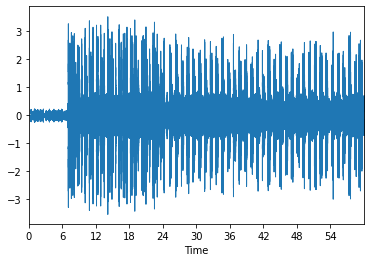

In [50]:
S_background = mask_i * S_filter * phase
back_y = librosa.istft(S_background)

librosa.display.waveplot(back_y)
IPython.display.Audio(data=back_y, rate=sr)

## **Sesta** parte, divisione del background nelle due parti :
###Nell'ultima parte del notebook, andremo a dividere in componente armonica e percussiva la traccia senza la parte vocale.

### Scomponiamo la traccia in parte armonica e percussiva
Per non ripetere le stesse operazioni questa volta utilizzeremo un metodo della libreria librosa che esegue in pipeline le operazioni effettuate in precedenza, quindi:

stft -> decompose.hpss -> istft

Otteniamo quindi le due parti già divise

In [51]:
back_harmonic, back_percussive = librosa.effects.hpss(back_y)

### Eseguo e plotto la parte armonica

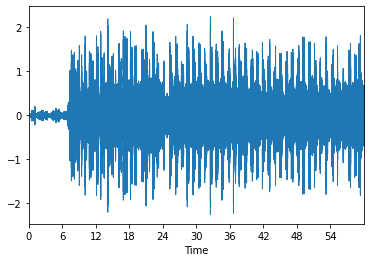

In [52]:
librosa.display.waveplot(back_harmonic)

IPython.display.Audio(data=back_harmonic, rate=sr)

### Eseguo e plotto la parte percussiva

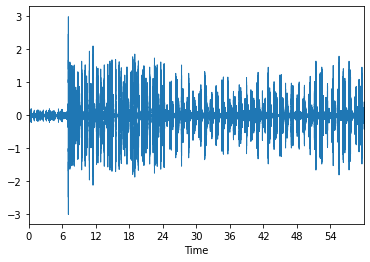

In [53]:
librosa.display.waveplot(back_percussive)

IPython.display.Audio(data=back_percussive, rate=sr)

# Risultati

## In questo notebook abbiamo scomposto la traccia audio in parte armonica e percussiva tramite applicazione di maschere. I risultati intermedi sono ottimi ma durante la parte cantata si crea confusione su parte armonica e percussiva e viene riprodotta in entrambi, sebbene nella parte percussiva sia poco presente.
##Dopo aver rimosso la parte vocale i risultati sono migliori da una parte, in quanto la voce viene rimossa quasi totalmente, ma peggiori dall'altra perché la maschera vocale ha sfasato la parte armonica della canzone.

##Tuttavia, il risultato varia molto dalla canzone che scegliamo perché la scomposizione avviene tramite maschere applicate alla traccia e il margine è fondamentale per la riuscita. Per ogni canzone bisogna trovare il margine ideale che riesca a isolare le singole parti, di seguito una parte extra per la dimostrazione. 

## **Parte Extra**, dimostrazione del margine ideale:
### In questa parte mostriamo come per una canzone diversa dalla precedente il risultato con gli stessi parametri non sia soddisfacente.

### Inizializziamo la seconda canzone

In [54]:
song = 'thatslife.wav'

duration = 60
y_extra, sr_extra = librosa.load(song, duration=duration)

y_extra_ft = librosa.stft(y_extra)

###Rimuoviamo la voce utilizzando lo stesso procedimento

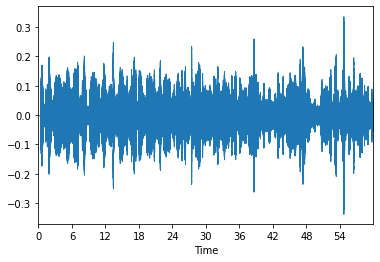

In [55]:
power=1.5
S_full = np.abs(y_extra_ft)
S_full **= power
phase = np.exp(1.0j * np.angle(y_extra_ft))

S_filter = librosa.decompose.nn_filter(S_full,
                                       aggregate=np.median,
                                       metric='cosine',
                                       width=int(librosa.time_to_frames(2, sr=sr_extra)))

S_filter= np.minimum(S_full, S_filter)

margin_i = 3
power = 2.5

mask_i_extra = librosa.util.softmask(S_filter, margin_i * (S_full - S_filter), power=power)

S_background = mask_i_extra * S_filter * phase
back_y_extra = librosa.istft(S_background)

librosa.display.waveplot(back_y_extra)
IPython.display.Audio(data=back_y_extra, rate=sr)

### Riscriviamo l'algoritmo
Questa volta non creiamo delle maschere ma andiamo direttamente a ritornare i due spettrogrammi con lo stesso margine.

In [56]:
harm_extra_old, perc_extra_old = librosa.decompose.hpss(S_background, margin=(5.0, 3.0))

y_extra_harm_old = librosa.istft(harm_extra_old)
y_extra_perc_old = librosa.istft(perc_extra_old)

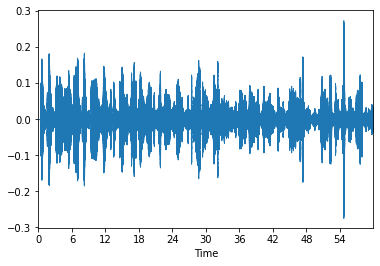

In [57]:
librosa.display.waveplot(y_extra_harm_old)
IPython.display.Audio(data=y_extra_harm_old, rate=sr_extra)

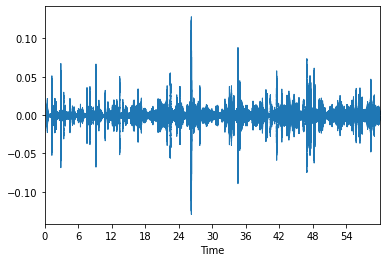

In [58]:
librosa.display.waveplot(y_extra_perc_old)
IPython.display.Audio(data=y_extra_perc_old, rate=sr_extra)

###Adesso invece con i margini ideali per la canzone

In [59]:
harm_extra, perc_extra = librosa.decompose.hpss(S_background, margin=(3.5, 4.5))

y_extra_harm = librosa.istft(harm_extra)
y_extra_perc = librosa.istft(perc_extra)

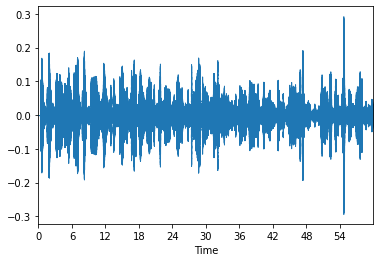

In [60]:
librosa.display.waveplot(y_extra_harm)
IPython.display.Audio(data=y_extra_harm, rate=sr_extra)

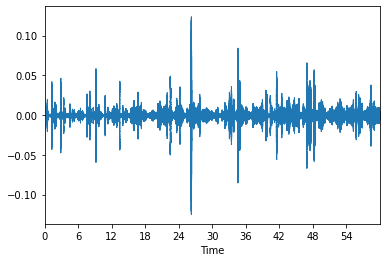

In [61]:
librosa.display.waveplot(y_extra_perc)
IPython.display.Audio(data=y_extra_perc, rate=sr_extra)

##Considerazioni finali
###La scelta della seconda canzone non è casuale, infatti è stata presa una canzone che fosse complicata da scomporre, le frequenze vocali non si riescono a rimuovere molto facilmente poiché sono molto simili alle note dell'organo in sottofondo e le singole parti quindi vengono influenzate dalla costante presenza dell'organo e della voce.

###Librosa è una libreria che ci permette di scrivere in poche righe un programma che ha molte funzionalità, tuttavia ha molti difetti perché la potenza di questo strumento è molto limitata